# Library load 

In [1]:
import sys
sys.path.insert(0, '../scripts/')

import kaggle_credit_default_utilities as kg
import pandas as pd
import numpy as np
import lightgbm as lbm
import sklearn
import shap
shap.initjs()

https://www.kaggle.com/c/home-credit-default-risk/discussion/64821

# Generate DF

In [6]:
df = kg.create_dataset(debug=False)

Train samples: 307511, test samples: 48744
Bureau df shape: (305811, 116)
Process bureau and bureau_balance - done in 27s
Previous applications df shape: (338857, 249)
Process previous_applications - done in 33s
Pos-cash balance df shape: (337252, 18)
Process POS-CASH balance - done in 14s
Installments payments df shape: (339587, 26)
Process installments payments - done in 29s
Credit card balance df shape: (103558, 141)
Process credit card balance - done in 19s


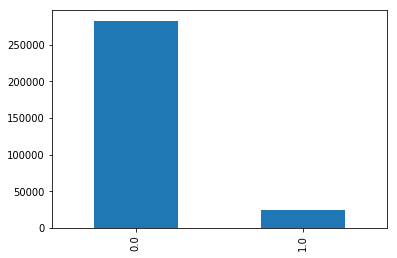

In [7]:
df['TARGET'].value_counts().plot(kind='bar')

In [8]:
df.head()

,index,AMT_ANNUITY,AMT_CREDIT,AMT_GOODS_PRICE,AMT_INCOME_TOTAL,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_WEEK,...,CC_NAME_CONTRACT_STATUS_Signed_MAX,CC_NAME_CONTRACT_STATUS_Signed_MEAN,CC_NAME_CONTRACT_STATUS_Signed_SUM,CC_NAME_CONTRACT_STATUS_Signed_VAR,CC_NAME_CONTRACT_STATUS_nan_MIN,CC_NAME_CONTRACT_STATUS_nan_MAX,CC_NAME_CONTRACT_STATUS_nan_MEAN,CC_NAME_CONTRACT_STATUS_nan_SUM,CC_NAME_CONTRACT_STATUS_nan_VAR,CC_COUNT
0,0,24700.5,406597.5,351000.0,202500.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,35698.5,1293502.5,1129500.0,270000.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,6750.0,135000.0,135000.0,67500.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,29686.5,312682.5,297000.0,135000.0,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0
4,4,21865.5,513000.0,513000.0,121500.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Train & stuff

In [10]:
%%time
feature_importance, datasets, model = kg.kfold_lightgbm(df, num_folds = 4, debug=True)

Starting LightGBM. Train shape: (307507, 798), test shape: (48744, 798)
Training until validation scores don't improve for 200 rounds.
[200]	training's auc: 0.799697	training's binary_logloss: 0.233335	valid_1's auc: 0.776043	valid_1's binary_logloss: 0.245166
[400]	training's auc: 0.824407	training's binary_logloss: 0.222966	valid_1's auc: 0.785519	valid_1's binary_logloss: 0.241271
[600]	training's auc: 0.840634	training's binary_logloss: 0.21633	valid_1's auc: 0.78875	valid_1's binary_logloss: 0.240072
[800]	training's auc: 0.853685	training's binary_logloss: 0.210879	valid_1's auc: 0.790014	valid_1's binary_logloss: 0.239602
[1000]	training's auc: 0.864923	training's binary_logloss: 0.206062	valid_1's auc: 0.790768	valid_1's binary_logloss: 0.239388
[1200]	training's auc: 0.875077	training's binary_logloss: 0.201453	valid_1's auc: 0.791076	valid_1's binary_logloss: 0.239298
[1400]	training's auc: 0.884775	training's binary_logloss: 0.196978	valid_1's auc: 0.79121	valid_1's binary_l

# SHAP

### Margin explainer

In [14]:
feats = [f for f in df.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV','index']]
sampled_df = sklearn.utils.resample(df[feats], n_samples=500, replace=False)
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(sampled_df)
shap.force_plot(explainer.expected_value, shap_values[0,:],sampled_df.iloc[[0]])

Expected value starts low, that means the model starts with the assumption that there's very low risk

what the model predicts

In [15]:
model.predict(np.array(sampled_df.iloc[[0]]).reshape(1, -1))

array([0.])

model probabilities

In [16]:
model.predict_proba(np.array(sampled_df.iloc[[0]]).reshape(1, -1))

array([[0.69927776, 0.30072224]])

Sigmoid function

In [17]:
import math
def sigmoid(x):
    return 1/(1+math.exp(-x))

RAW output then sigmoid

In [18]:
sigmoid(-0.84)

0.30153478399746125

# Relative importance for a given prediction: The *log*

In [19]:
def get_relative_importance(explainer, names, obv):
    """
    Calculates the relative importance to the overall prediction. This is not translated into probability impact,
    but gives a better idea of the magnitude of a variable in the context of the others.
    
    The provided _explainer_ is applied to the provided observation (in _values_). Then the absolute shap values are 
    sumed and a percent is calculated from that total by feature (without the base value!)
    
    A dataframe is returned with the results
    
    Params:
       * explainer: SHAP explainer
       * names: column names of the features
       * values: column values of the observation
    """
    shap_values_obvs = explainer.shap_values(obv)
    interpretation = pd.DataFrame({"name":names,"value":shap_values_obvs[0]})
    interpretation['impact_from_base'] = interpretation['value'].abs()
    interpretation['impact_from_base'] = (interpretation['impact_from_base'] / interpretation['impact_from_base'].sum())
    return interpretation.sort_values(by=['impact_from_base'], ascending=False)

In [20]:
get_relative_importance(explainer, sampled_df.columns, sampled_df.iloc[[0]])

,name,value,impact_from_base
37,EXT_SOURCE_3,0.588656,0.108437
36,EXT_SOURCE_2,0.430363,0.079278
35,EXT_SOURCE_1,0.124767,0.022984
18,CODE_GENDER,0.116860,0.021527
630,INSTAL_DPD_MEAN,-0.095876,0.017661
435,PREV_NAME_CONTRACT_STATUS_Refused_MEAN,0.091297,0.016818
257,BURO_AMT_CREDIT_SUM_MEAN,-0.089923,0.016565
23,DAYS_EMPLOYED,0.084216,0.015514
244,PAYMENT_RATE,0.074316,0.013690
92,OWN_CAR_AGE,-0.073334,0.013509


Your actual predict call could look a bit like this

In [21]:
def predict_value(model, explainer, names, values):
    prediction = model.predict(np.array(values).reshape(1, -1))
    explanation = get_relative_importance(explainer, names, values)
    return {'prediction':prediction, 'explanation':explanation.to_dict(orient='records')}

In [22]:
predict_value(model, explainer,sampled_df.columns, sampled_df.iloc[[0]])

{'prediction': array([0.]),
 'explanation': [{'name': 'EXT_SOURCE_3',
   'value': 0.588655868842767,
   'impact_from_base': 0.10843698492831734},
  {'name': 'EXT_SOURCE_2',
   'value': 0.4303625183728908,
   'impact_from_base': 0.07927758201112729},
  {'name': 'EXT_SOURCE_1',
   'value': 0.12476723267767449,
   'impact_from_base': 0.022983517612784762},
  {'name': 'CODE_GENDER',
   'value': 0.11685967571262365,
   'impact_from_base': 0.021526857311198497},
  {'name': 'INSTAL_DPD_MEAN',
   'value': -0.09587562210946095,
   'impact_from_base': 0.01766136029547276},
  {'name': 'PREV_NAME_CONTRACT_STATUS_Refused_MEAN',
   'value': 0.09129718637771955,
   'impact_from_base': 0.01681796130343668},
  {'name': 'BURO_AMT_CREDIT_SUM_MEAN',
   'value': -0.08992267975691094,
   'impact_from_base': 0.016564761833910445},
  {'name': 'DAYS_EMPLOYED',
   'value': 0.08421644385199993,
   'impact_from_base': 0.015513609455128105},
  {'name': 'PAYMENT_RATE',
   'value': 0.0743158473125263,
   'impact_fro

Or send that second part to *logging.debug(explanation)* for example, in a different call if reponse time is critical

## Alterative: Explain probs

Keep in mind is an alternative method and won't match 1-1

In [23]:
explainer = shap.TreeExplainer(model, sampled_df, model_output='probability',feature_dependence='independent')
shap_values = explainer.shap_values(sampled_df)

 99%|===================| 496/500 [02:47<00:01]        

In [24]:
shap.force_plot(explainer.expected_value, shap_values[0,:], sampled_df.iloc[[0]])

In [25]:
explainer.expected_value

0.08052792167000618

In [26]:
tmpdf = pd.DataFrame({"name":sampled_df.columns,"probs":explainer.shap_values(sampled_df.iloc[[0]])[0]})
tmpdf['abs_probs'] = tmpdf['probs'].abs() * 100
tmpdf.sort_values(by=['abs_probs'], ascending=False)

,name,probs,abs_probs
37,EXT_SOURCE_3,0.059963,5.996274
36,EXT_SOURCE_2,0.041119,4.111930
18,CODE_GENDER,0.015931,1.593143
35,EXT_SOURCE_1,0.014989,1.498943
630,INSTAL_DPD_MEAN,-0.013180,1.318045
257,BURO_AMT_CREDIT_SUM_MEAN,-0.011749,1.174862
435,PREV_NAME_CONTRACT_STATUS_Refused_MEAN,0.011356,1.135638
2,AMT_GOODS_PRICE,0.011080,1.107958
323,ACTIVE_AMT_CREDIT_SUM_DEBT_SUM,0.010773,1.077261
92,OWN_CAR_AGE,-0.010747,1.074653


# Back to margins mode

In [27]:
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(sampled_df)

# Feature importance

Original VS shap

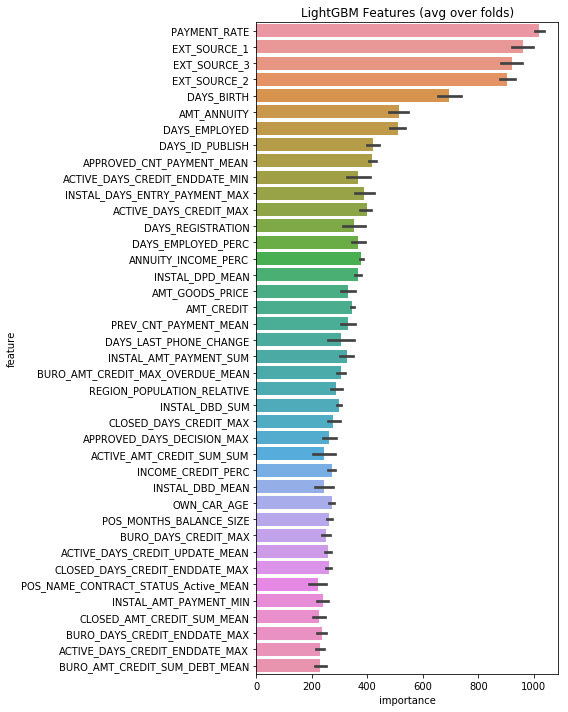

In [28]:
kg.display_importances(feature_importance)

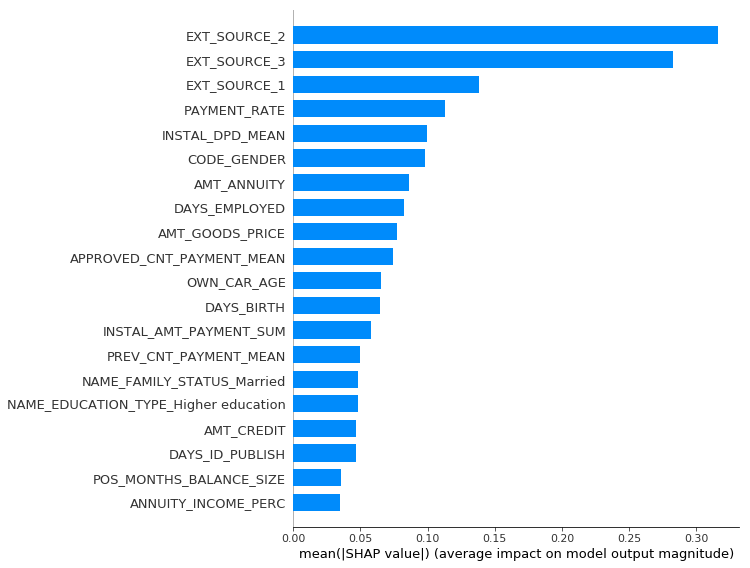

In [29]:
shap.summary_plot(shap_values, sampled_df, plot_type="bar")

In this case, the variables with the biggest impact are (what appears to be) external sources... ? Is that a good sign?

# Dependence Plot

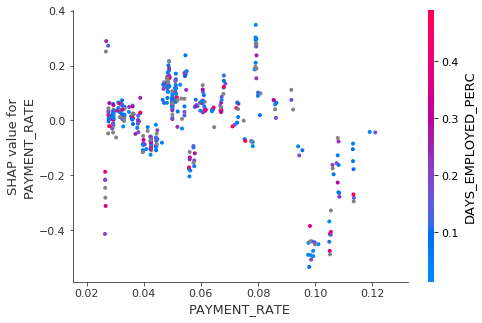

In [30]:
shap.dependence_plot("PAYMENT_RATE", shap_values, sampled_df)

Payment_rate indicates that how it impacts the model varies a lot.

<0.05 is a sighly-to-none negative impact, the same with >0.09

Between that interval, the impact is positive, and overall, independet of ext_source_3

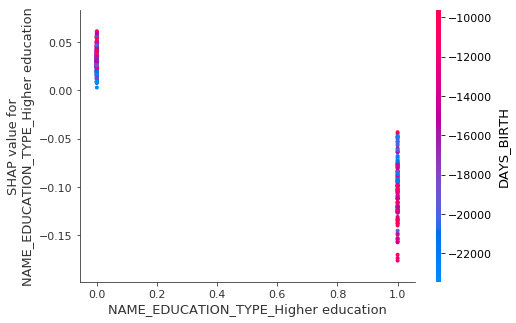

In [31]:
# create a SHAP dependence plot to show the effect of a single feature across the whole dataset
shap.dependence_plot("NAME_EDUCATION_TYPE_Higher education", shap_values, sampled_df)

HUUUUMMMMMMmmmmmmm...... education, huh...

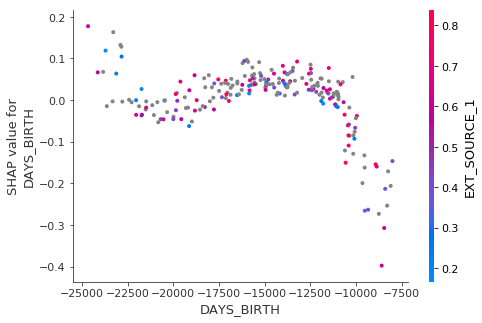

In [32]:
# create a SHAP dependence plot to show the effect of a single feature across the whole dataset
shap.dependence_plot("DAYS_BIRTH", shap_values, sampled_df)

The older you are, the less propension to default.

Between X-Y, almost nothing

Younger than X is about how much does impact your propension to default

# Trainingset breakdown


This is basically applying shap to the whole datset, mind that.

**warning**: Don't attempt to plot the **whole** dataset, because no one want's to plot > 300k observations here. We are using a sample of 500 here.

In [33]:
# visualize the training set predictions
#sampled_df = sklearn.utils.resample(df[feats], n_samples=1000, replace=False)
#shap_values = explainer.shap_values(sampled_df)
shap.force_plot(explainer.expected_value, shap_values, sampled_df)

# Overall feature effect

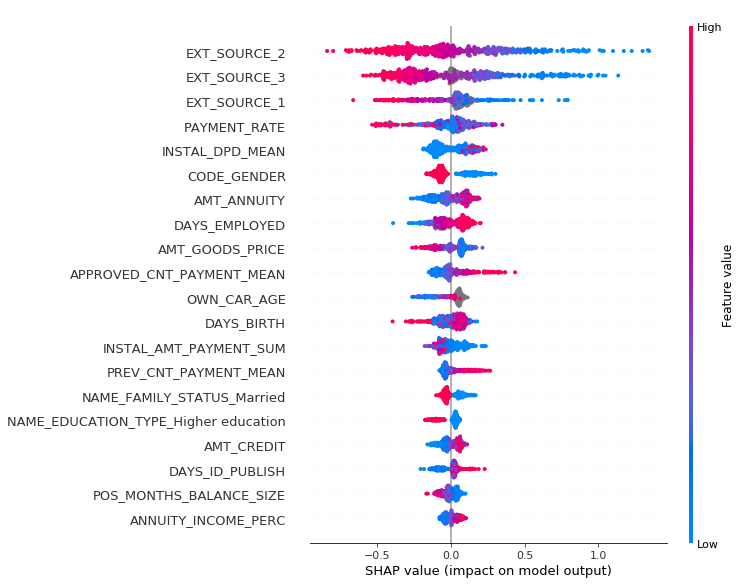

In [34]:
# summarize the effects of all the features
shap.summary_plot(shap_values, sampled_df)